In [ ]:
#grid box 內的center to center offset應該要依照grid box的邊長校正到-0.5到0.5之間
#還原object map的部分也要依上述校正

#校正確認無誤後記得修改Data.py的內容

In [1]:
import tensorflow as tf
import json
import numpy as np
import cv2
import pathlib
from sklearn.model_selection import train_test_split

In [3]:
image_shape = (1024,1024)
label_folder = r'D:\Competitions\ComputerVision\OCR\Signalboard\dataset\train\label\custom'
image_folder = r'D:\Competitions\ComputerVision\OCR\Signalboard\dataset\train\image\official'
validation_ratio = 0.05
random_state = 100
batch_size = 8

object_map_param = [
    (128,(0,36)),
    (64,(37,76)),
    (32,(77,156)),
    (16,(157,316)),
    (8,(317,636)),
    (8,(637,892)),
    (8,(892,1024))
]

In [24]:
image_shape = (1024,1024)
label_folder = r'C:\Users\Atlas\Desktop\Sinalboard_OCR\dataset\train\label\custom'
image_folder = r'C:\Users\Atlas\Desktop\Sinalboard_OCR\dataset\train\image\official'
validation_ratio = 0.05
random_state = 100
batch_size = 8

# object_map_param = [
#     (128,(0,36)),
#     (64,(37,76)),
#     (32,(77,156)),
#     (16,(157,316)),
#     (8,(317,636)),
#     (8,(637,892)),
#     (8,(892,1024))
# ]
object_map_param = [
    (128,(0,8)),
    (64,(9,16)),
    (32,(17,32)),
    (16,(33,64)),
    (8,(65,128)),
    (8,(129,256)),
    (8,(257,1024))
]

In [25]:
class Dataset:
    def __init__(self,label_folder,image_folder,batch_size,image_shape,object_map_param):
        self.label_folder = label_folder
        self.image_folder = image_folder
        self.batch_size = batch_size
        self.image_shape = image_shape
        self.object_map_param = object_map_param
    
    def split(self,validation_ratio,random_state):
        labels = [l.as_posix() for l in pathlib.Path(self.label_folder).iterdir()]
        train_labels, validation_labels = train_test_split(labels,test_size=validation_ratio,random_state=random_state)
        train_data = self.create_dataset(train_labels,False)
        validation_data = self.create_dataset(validation_labels,True)
        return train_data, validation_data
    
    def create_dataset(self,labels,is_validation):
        dataset = tf.data.Dataset.from_tensor_slices(labels)
        dataset = dataset.map(
            lambda path: tf.py_function(
                self.decode_json,
                [path],
                [tf.string, tf.int32, tf.float64, tf.float64, tf.float64]),
            num_parallel_calls=tf.data.AUTOTUNE
        )
        dataset = dataset.cache()
        if not is_validation:
            dataset = dataset.shuffle(buffer_size=5000)
        dataset = dataset.map(
            lambda image_path, group, center, wh, offset: tf.py_function(
                self.image_preprocess,
                [image_path, group, center, wh, offset],
                [tf.string, tf.float32, tf.int32, tf.float64, tf.float64, tf.float64]),
            num_parallel_calls=tf.data.AUTOTUNE
        )
        if not is_validation:
            dataset = dataset.map(
            lambda image_path, image, group, center, wh, offset: tf.py_function(
                self.argumentation,
                [image_path, image, group, center, wh, offset],
                [tf.string, tf.float32, tf.int32, tf.float64, tf.float64, tf.float64]),
            num_parallel_calls=tf.data.AUTOTUNE
        )
        dataset = dataset.map(
            lambda image_path, image, group, center, wh, offset: tf.py_function(
                self.transform,
                [image_path, image, group, center, wh, offset],
                [tf.string, tf.float32]+[tf.float64]*len(self.object_map_param)),
            num_parallel_calls=tf.data.AUTOTUNE
        )
        dataset = dataset.batch(self.batch_size, num_parallel_calls=tf.data.AUTOTUNE)
        dataset = dataset.prefetch(tf.data.AUTOTUNE)
        return dataset
        
    def decode_json(self,path):
        label = json.loads(tf.io.read_file(path).numpy())

        image_path = tf.strings.join([self.image_folder,label['ImageName']],'/')
        
        group = np.array([[b['type']] if b['type']!=255 else [6] for b in label['bboxes']])
        center = np.array([b['rectangle']['center'] for b in label['bboxes']])
        wh = np.array([b['rectangle']['ltwh'][2:] for b in label['bboxes']])
        
        rectangle = np.array([b['rectangle']['points'] for b in label['bboxes']])
        polygon = np.array([b['polygon']['points'] for b in label['bboxes']])
        offset = polygon - rectangle
        
        return image_path, group, center, wh, offset
    
    def image_preprocess(self, image_path, group, center, wh, offset):
        image = tf.io.decode_jpeg(tf.io.read_file(image_path))
        image = tf.image.convert_image_dtype(image,tf.float32)
        image = tf.image.resize(image,self.image_shape)
        image = tf.clip_by_value(image,0,1)
        return image_path, image, group, center, wh, offset
    
    def argumentation(self, image_path, image, group, center, wh, offset):
        group = group.numpy()
        center = center.numpy()
        wh = wh.numpy()
        offset = offset.numpy()
        
        if np.random.choice([True,False],p=[0.4,0.6]):
            if np.random.choice([True,False],p=[0.7,0.3]):
                image = tf.image.random_contrast(image,0.5,2)
                image = tf.clip_by_value(image,0,1)

            if np.random.choice([True,False],p=[0.7,0.3]):
                image = tf.image.random_hue(image,0.25)
                image = tf.clip_by_value(image,0,1)

            if np.random.choice([True,False],p=[0.7,0.3]):
                image = tf.image.random_brightness(image,0.25)
                image = tf.clip_by_value(image,0,1)

            if np.random.choice([True,False],p=[0.7,0.3]):
                image = tf.image.random_saturation(image,0.5,2)
                image = tf.clip_by_value(image,0,1)
            
        if np.random.choice([True,False],p=[0.3,0.7]):
            image, center, wh, offset = self.random_resize(image, center, wh, offset)
        
        return image_path, image, group, center, wh, offset
    
    def transform(self, image_path, image, group, center, wh, offset):
        group = group.numpy()
        center = center.numpy()
        wh = wh.numpy()
        offset = offset.numpy()
        
        determine = np.ceil(np.max(wh*np.array(self.image_shape[::-1]),axis=-1)).astype(int)
        bboxes_order = np.argsort(determine)
        determine = determine[bboxes_order]
        group = group[bboxes_order]
        center = center[bboxes_order]
        wh = wh[bboxes_order]
        offset = offset[bboxes_order]
        
        object_maps = []
        for grid_count, object_determine_size_range in self.object_map_param:
            smallest, biggest = object_determine_size_range
            mask = ((smallest<=determine) & (determine<=biggest))

            blood = 1/(grid_count*2)
            grid_center_coor = np.linspace(0+blood,1-blood,grid_count)
            
            matched_group = group[mask]
            cxcy = center[mask]
            matched_wh = wh[mask]
            points_offset = offset[mask]

            belonging = (cxcy*grid_count).astype(int)
            match_grid_center_coor = np.stack([grid_center_coor[belonging[:,0]],grid_center_coor[belonging[:,1]]],axis=-1)

            center_offset = (cxcy - match_grid_center_coor)*grid_count*2
            
            answer = np.concatenate([matched_group,center_offset,matched_wh,points_offset.reshape(-1,8)],axis=-1)
            object_map = np.zeros((grid_count,grid_count,1+(1+(2+2)+(4*2))))
            object_map[belonging[:,1],belonging[:,0],0] = 1
            object_map[belonging[:,1],belonging[:,0],1:] = answer

            object_maps.append(object_map)
        return image_path, image, *object_maps
    
    
    def random_resize(self,image, center, wh, offset):
        w_rate,h_rate = np.random.uniform(0.5,1,2)
        new_shape = (np.array([h_rate,w_rate]) * image.shape[:2]).astype(int)
        
        resized_image = tf.image.resize(image,new_shape)
        resized_image = tf.clip_by_value(resized_image,0,1)
        
        center = center * np.array([w_rate,h_rate])
        wh = wh * np.array([w_rate,h_rate])
        offset = offset * np.array([w_rate,h_rate])
        
        image_x_diff = self.image_shape[1]-new_shape[1]
        image_y_diff = self.image_shape[0]-new_shape[0]
        
        image_x_offset = np.random.randint(0,image_x_diff+1)
        image_y_offset = np.random.randint(0,image_y_diff+1)
        
        new_image = tf.pad(resized_image,
                           [
                               [image_y_offset,image_y_diff-image_y_offset],
                               [image_x_offset,image_x_diff-image_x_offset],
                               [0,0]
                           ])
        
        image_offset = np.array([image_x_offset/self.image_shape[1],image_y_offset/self.image_shape[0]])
        
        center = center + image_offset
        
        return new_image, center, wh, offset

In [26]:
t,v = Dataset(label_folder,image_folder,batch_size,image_shape,object_map_param).split(validation_ratio,random_state)

8
[]
16
[]
32
[]
64
[[218.82830528 756.52916011  55.37978539  33.83493948]]
128
[[373.58825349 756.52916011  85.72487327  33.83493948]
 [452.48548199 756.52916011  73.58683812  33.1965444 ]
 [537.83104166 757.1675552   65.24193895  28.7277788 ]]
128
[[692.59098987 755.41196871 210.89836079  38.62290261]]
128
[[339.82934322 755.57156749 301.93362444  37.0269149 ]]


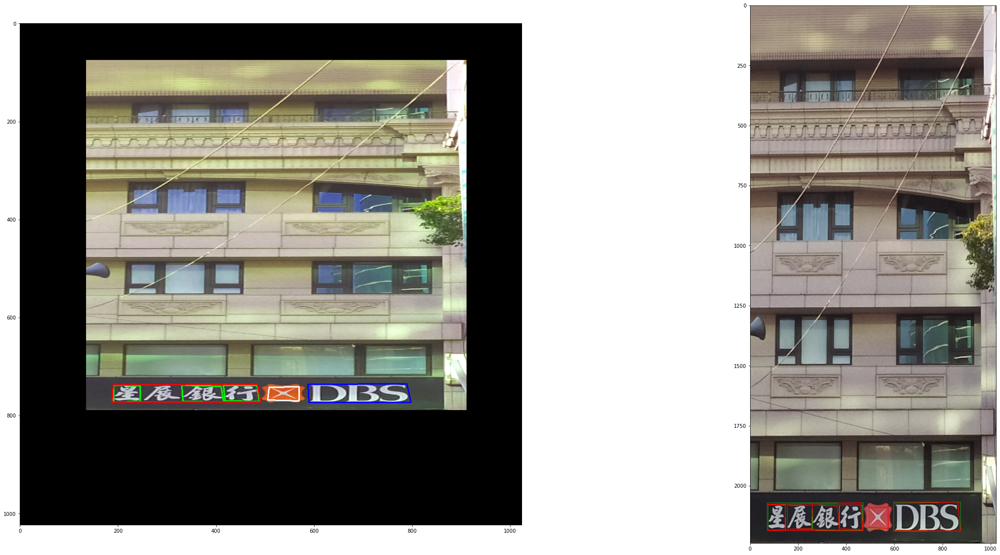

8
[]
16
[]
32
[]
64
[[373.96630037 679.          47.26153846  60.        ]
 [374.34139194 769.          48.01172161  60.        ]]
128
[[211.55164835 592.5         51.01245421  69.        ]
 [265.56483516 594.          45.01098901  70.        ]
 [485.36849817 594.5         51.01245421  69.        ]
 [208.55091575 681.5         52.51282051  73.        ]
 [318.45274725 681.5         51.76263736  73.        ]
 [427.97948718 682.          48.76190476  68.        ]
 [319.2029304  768.5         50.26227106  69.        ]
 [486.86886447 768.5         54.01318681  73.        ]
 [632.4043956  832.          82.52014652  42.        ]
 [928.35164835 833.5         92.27252747  47.        ]]
128
[[731.42857143 569.         102.02490842 172.        ]
 [823.7010989  670.5         99.02417582 185.        ]
 [755.05934066 831.         141.78461538  44.        ]]
128
[[348.46007326 593.5        324.82930403  71.        ]
 [346.20952381 681.5        329.33040293  73.        ]
 [345.83443223 768.         33

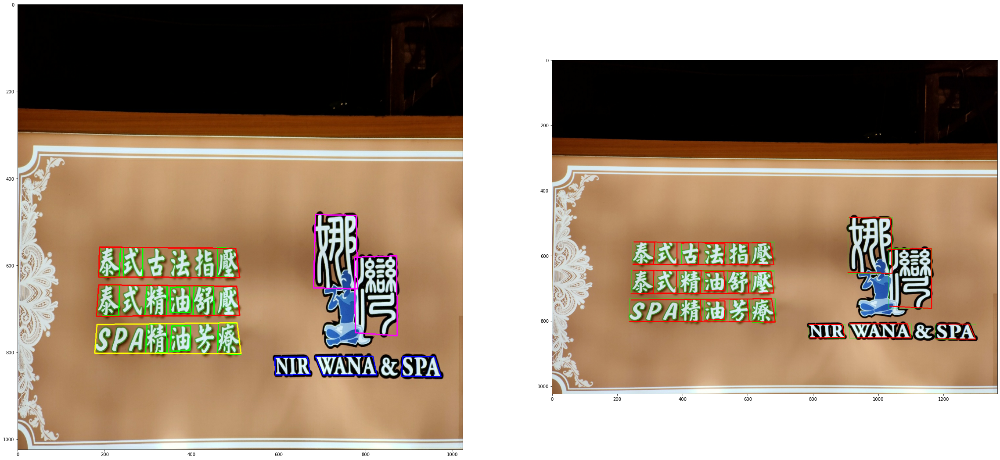

8
[]
16
[]
32
[]
64
[[894.5         12.37802198  55.          24.75604396]]
128
[[992.          15.003663    66.          30.00732601]
 [966.         459.11208791  76.          70.51721612]]
128
[]
128
[[173.5        397.97216117 347.         252.81172161]
 [563.5        480.49230769 283.         296.32234432]
 [885.         548.38388278 268.         291.07106227]]


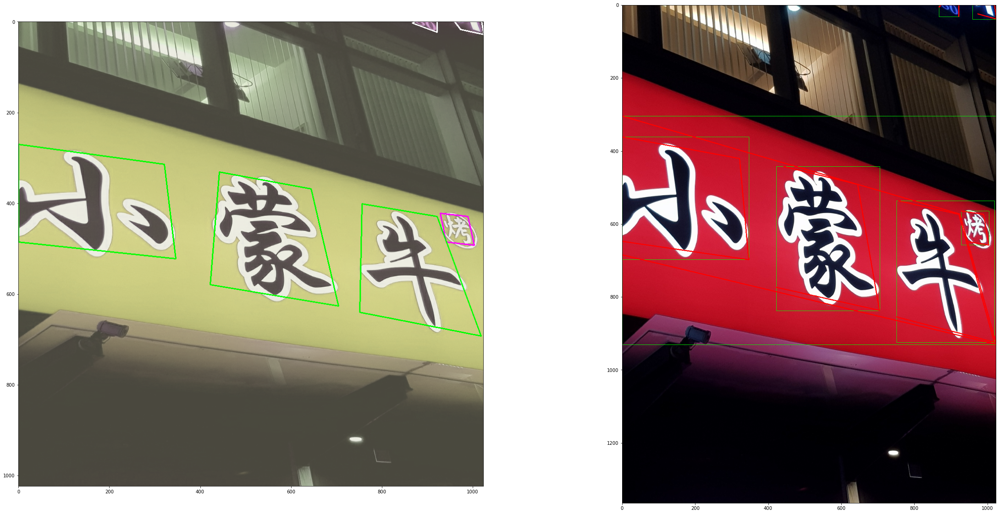

8
[]
16
[[344.         882.21538462  12.          10.5025641 ]
 [362.5        881.09010989  11.          11.25274725]]
32
[[610.5        925.35091575  23.          18.75457875]
 [471.5        933.97802198  19.          18.0043956 ]
 [489.         933.22783883  18.          18.0043956 ]
 [566.         928.35164835  20.          15.75384615]]
64
[[766.5        767.43736264  37.          30.00732601]
 [824.5        758.81025641  37.          30.75750916]
 [856.5        755.80952381  41.          32.25787546]
 [922.         748.68278388  42.          33.00805861]
 [735.         770.43809524  36.          30.00732601]
 [363.5        881.09010989  53.          12.75311355]
 [437.         876.58901099  62.          14.25347985]
 [606.5        894.96849817  45.          43.51062271]
 [694.5        887.46666667  49.          42.01025641]
 [362.         940.35457875  64.          18.75457875]
 [417.         905.84615385  36.          33.75824176]
 [454.         903.97069597  38.          36.0087

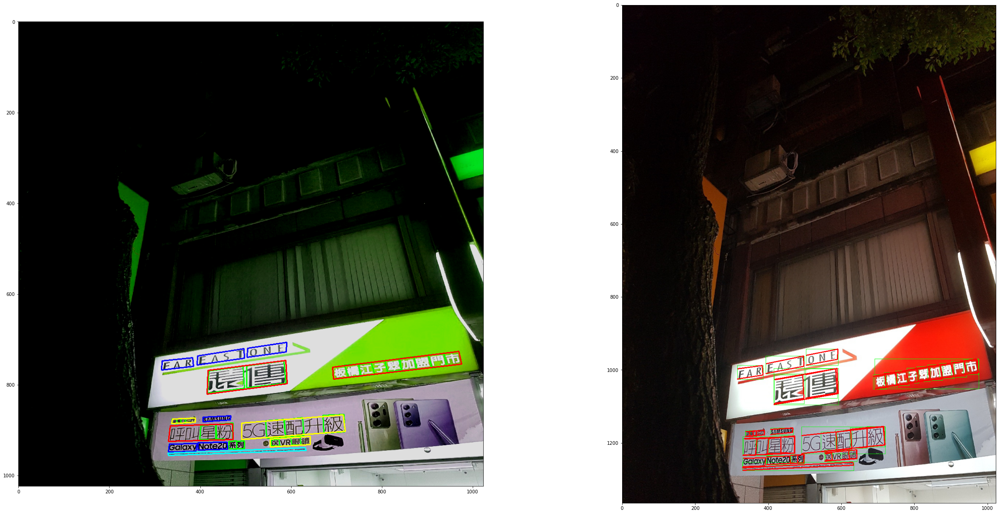

8
[]
16
[]
32
[[850.98790194 914.28218594  28.91221476  27.1126914 ]
 [314.71295078 971.48996479  21.45099805  18.97888398]]
64
[[793.62979847 929.19416621  35.44077938   9.21831507]
 [269.01299842 983.419549    38.23873565   8.13380742]]
128
[]
128
[[288.59869229 611.43342304 165.07941975 113.33105004]
 [511.03621551 580.25382793 171.60798437 121.46485746]
 [744.19923775 546.36296369 173.47328855 119.83809597]
 [275.075237   731.54264593 154.82024677 116.04231918]
 [424.29957123 711.20812738 151.08963841 117.66908066]
 [575.85553569 690.06022809 157.61820304 118.75358832]
 [739.06965126 667.0144404  168.8100281  122.54936511]]
128
[[519.43008431 579.16932028 634.2034205  187.61982447]
 [511.03621551 696.56727403 632.33811632 187.07757064]
 [612.22896716 938.6836082  316.16905816  55.30989045]]


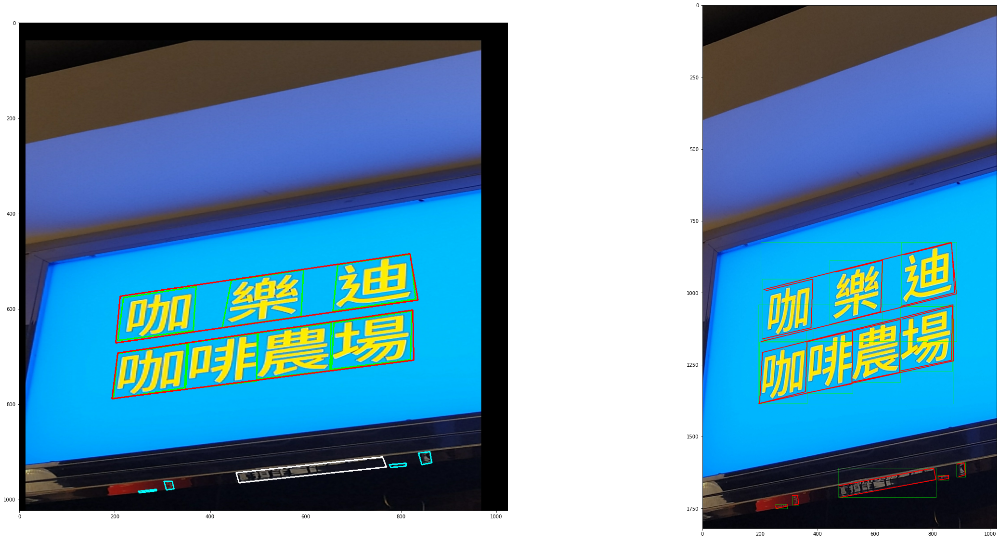

8
[]
16
[]
32
[]
64
[[564.14814815 847.          29.49794239  42.        ]]
128
[[547.55555556 541.5         42.66666667 125.        ]
 [684.51028807 567.5         51.09465021 125.        ]
 [589.69547325 699.5         64.79012346  53.        ]]
128
[[505.15226337 574.5         43.19341564 131.        ]
 [595.48971193 544.         233.34979424 198.        ]
 [593.64609053 649.         161.18518519  94.        ]]
128
[]


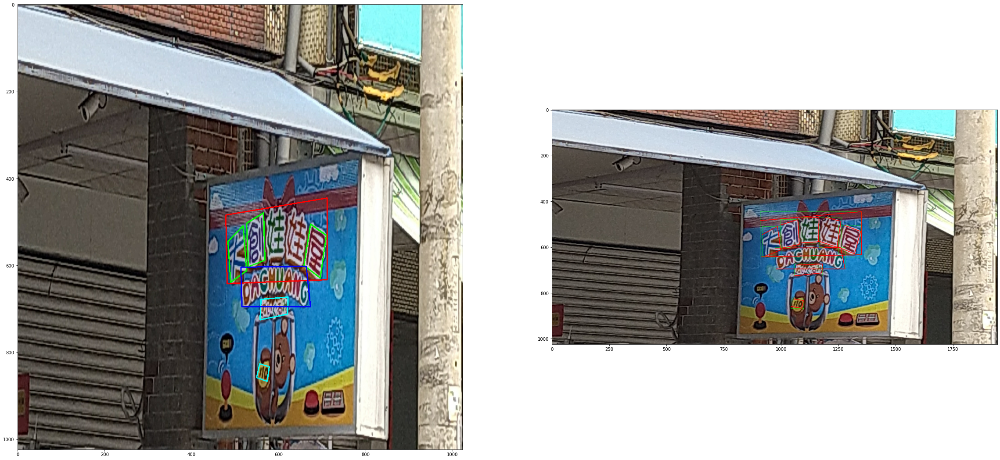

8
[]
16
[]
32
[]
64
[]
128
[[164.         747.43699337  98.          89.79808401]
 [302.         724.42151805 110.         105.64480472]
 [437.         704.04716286 128.         111.6816507 ]
 [581.5        681.03168755 123.         104.89019897]]
128
[[100.5        473.13780398  47.         184.12380251]
 [909.5        639.52837141 151.         124.50994842]
 [744.5        664.43036109 135.         106.39941046]]
128
[[549.5        685.93662491 875.         226.38172439]]


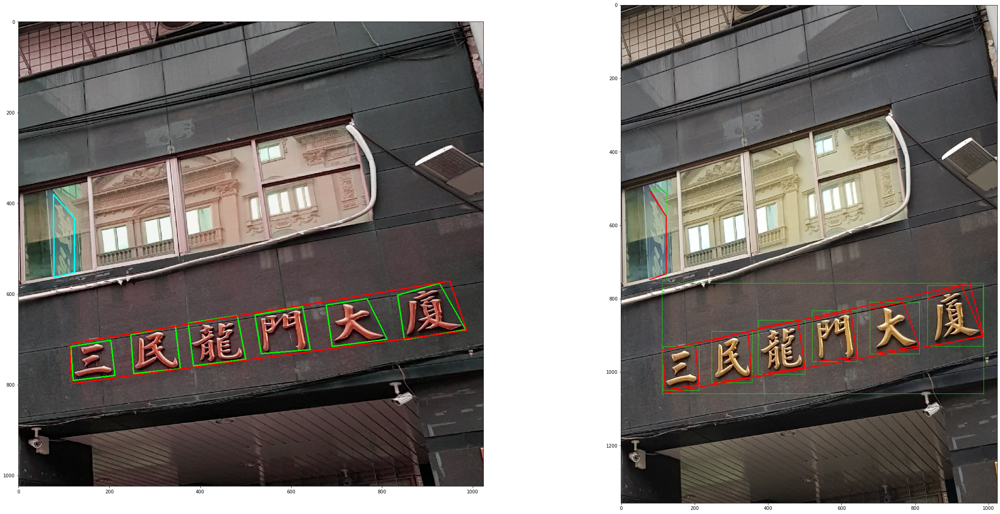

8
[]
16
[]
32
[[641.19710903 624.47563656   9.01099734  28.8054458 ]]
64
[[581.6244044  618.78153681  30.03665779  61.63025613]]
128
[[104.54215646 596.67503189  65.07942522  69.6689852 ]
 [188.89510376 608.06323139  49.56048536  72.34856155]
 [361.60588607 608.39817844 105.62891324  91.77549011]
 [392.64376579 602.36913164  43.5531538   81.0571847 ]
 [562.10057684 608.73312548  69.08431292  81.72707879]]
128
[[142.83889515 601.36429051 142.67412452  87.08623149]]
128
[]


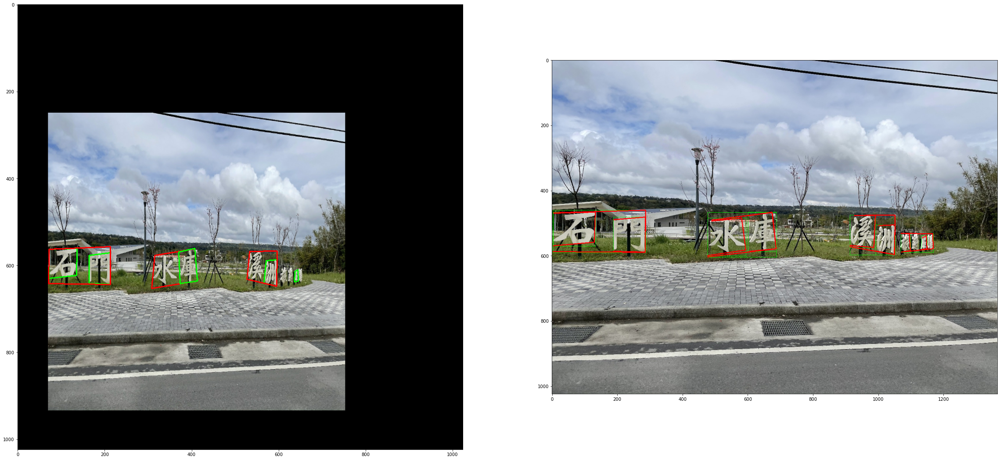

In [27]:
import matplotlib.pyplot as plt

for i in zip(*next(iter(t.take(1)))):
    path,img,omaps = i[0],i[1],i[2:]

    polygons = []
    for omap in omaps:
        omap = omap.numpy()
        loc = np.where(omap[...,0] == 1)

        grid_count = omap.shape[0]
        blood = 1/(grid_count*2)
        grid_center_coor = np.linspace(0+blood,1-blood,grid_count)

        match_grid_center_coor = np.stack([grid_center_coor[loc[1]],grid_center_coor[loc[0]]],axis=-1)
        ans = omap[loc[0],loc[1],:]
        center_offset = (ans[:,[2,3]])/(grid_count*2)
        
        wh = ans[:,[4,5]]
        polygon_offset = ans[:,6:].reshape(-1,4,2)
        center = center_offset + match_grid_center_coor
        print(1024//grid_count)
        print(np.concatenate([center,wh],axis=-1)*1024)
        rect = np.stack([
            center + wh/2*np.array([-1,-1]),
            center + wh/2*np.array([1,-1]),
            center + wh/2*np.array([1,1]),
            center + wh/2*np.array([-1,1]),
        ],axis=1)

        polygon = polygon_offset + rect
        group = ans[:,1].astype(int)
        colors = [
            (1,0,0),
            (0,1,0),
            (0,0,1),
            (1,1,0),
            (1,0,1),
            (0,1,1),
            (1,1,1),
        ]
        polygon = (polygon*np.array([img.shape[1],img.shape[0]])).astype(int)
        polygons.extend(zip(polygon,map(lambda c: colors[c],group)))
    
    img = img.numpy()
    for p,c in polygons:
        img = cv2.polylines(img,[p],True,c,2)

    plt.figure(figsize=(40,20))
    plt.subplot(1,2,1)
    plt.imshow(img)

    name = str(path.numpy()).split('/')[-1].replace(".jpg'",'.json')
    x = json.loads(pathlib.Path(r'C:\Users\Atlas\Desktop\Sinalboard_OCR\dataset\train\label\custom').joinpath(name).read_text(encoding='utf8'))
    img = plt.imread(pathlib.Path(r'C:\Users\Atlas\Desktop\Sinalboard_OCR\dataset\train\image\official').joinpath(x['ImageName']))
    
#     x = json.loads(pathlib.Path(r'D:\Competitions\ComputerVision\OCR\Signalboard\dataset\train\label\custom').joinpath(name).read_text(encoding='utf8'))
#     img = plt.imread(pathlib.Path(r'D:\Competitions\ComputerVision\OCR\Signalboard\dataset\train\image\official').joinpath(x['ImageName']))

    rects = np.array([b['rectangle']['points'] for b in x['bboxes']])
    rects = (rects * np.array([x['ImageWidth'],x['ImageHeight']])).astype(int)

    polygon = np.array([b['polygon']['points'] for b in x['bboxes']])
    polygon = (polygon * np.array([x['ImageWidth'],x['ImageHeight']])).astype(int)

    img = cv2.polylines(img,rects,True,(0,255,0))
    img = cv2.polylines(img,polygon,False,(255,0,0),2)

    plt.subplot(1,2,2)
    plt.imshow(img)
    plt.show()